# Predict PM2.5 Concentration in Various Locations Around China

**Data:** 

The China AQI air quality observations (Feb 2014 - Feb 2016) from ground monitoring stations archive will be used, which can be accessed through the following link: https://dataverse.harvard.edu/dataset.xhtml?persistentId=doi:10.7910/DVN/GHOXXO    

The observations are collected and stored PostGresql (3 times a day). The AQI values are coded to locations, which have mappable x, y coordinates.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

## Acquiring the data

In [2]:
data = pd.read_csv('aqi_observations_to_2016-02-04.csv')
data.head()  

/Users/charlottefettes/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3051: DtypeWarning: Columns (6,7,8,9,10,11,12,13,15,16) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,rowid,locationid,stationname,chinesename,latitude,longitude,pm25,pm10,o3,no2,so2,co,temperature,dewpoint,pressure,humidity,wind,est_time,unix_time
0,120250,522,"Chengbei water plant, Huzhou",湖州市城北水厂,30.891155,120.096593,134,81,31,20,15,14,20,10,1016.0,52,13,20140324110000,1395658800
1,120251,523,"Jishan new village, Huzhou",湖州市吉山新村,30.859939,120.120168,158,83,47,34,14,10,19,11,1016.0,60,9,20140324110000,1395658800
2,120252,524,"Town west water plant, Huzhou",湖州市城西水厂,30.862371,120.084577,147,100,39,31,11,9,19,11,1016.0,60,9,20140324110000,1395658800
3,120253,525,Huzhou,湖州,30.892304,120.091694,151,74,44,26,10,11,19,11,1016.0,60,9,20140324110000,1395658800
4,120254,526,"Donghu middle school, Shaoxing",绍兴市东湖中学,29.990447,120.647547,78,51,39,7,2,9,22,8,1016.0,41,4,20140324110000,1395658800


## Selecting relevant features

+ Focus on pm2.5 air pollutant
+ Unix time used - est time and unix time will differ from China time (12 hours and 28800s respectively; only need to convert one for timestamp)

In [3]:
data = data[['locationid','stationname','latitude','longitude','pm25','temperature','dewpoint','pressure','humidity','wind','unix_time']]
data.head()

,locationid,stationname,latitude,longitude,pm25,temperature,dewpoint,pressure,humidity,wind,unix_time
0,522,"Chengbei water plant, Huzhou",30.891155,120.096593,134,20,10,1016.0,52,13,1395658800
1,523,"Jishan new village, Huzhou",30.859939,120.120168,158,19,11,1016.0,60,9,1395658800
2,524,"Town west water plant, Huzhou",30.862371,120.084577,147,19,11,1016.0,60,9,1395658800
3,525,Huzhou,30.892304,120.091694,151,19,11,1016.0,60,9,1395658800
4,526,"Donghu middle school, Shaoxing",29.990447,120.647547,78,22,8,1016.0,41,4,1395658800


## Exploring and cleaning the data

In [4]:
#number of unique location ids
len(data['locationid'].unique())

1655

In [5]:
#number of rows and columns
data.shape

(2542745, 11)

In [6]:
#is data in correct types within columns?
data.dtypes

locationid       int64
stationname     object
latitude       float64
longitude      float64
pm25            object
temperature     object
dewpoint        object
pressure       float64
humidity        object
wind            object
unix_time        int64
dtype: object

In [7]:
#convert data from object to into numerical - separate as takes too long to do all at once
cols = ['pm25','temperature','dewpoint','humidity','wind']

for col in cols:
    data[col] = data[col].apply(pd.to_numeric, errors='coerce')

In [8]:
data.dtypes

locationid       int64
stationname     object
latitude       float64
longitude      float64
pm25           float64
temperature    float64
dewpoint       float64
pressure       float64
humidity       float64
wind           float64
unix_time        int64
dtype: object

In [9]:
data.describe().transpose().round(2)

,count,mean,std,min,25%,50%,75%,max
locationid,2542745.0,7.797700e+02,471.28,1.000000e+00,4.080000e+02,7.460000e+02,1.132000e+03,2.063000e+03
latitude,2542745.0,3.345000e+01,6.56,1.822000e+01,2.908000e+01,3.396000e+01,3.881000e+01,5.026000e+01
longitude,2542745.0,1.143100e+02,7.61,7.595000e+01,1.109300e+02,1.153700e+02,1.191500e+02,1.311700e+02
pm25,2452073.0,1.186000e+02,65.43,0.000000e+00,7.100000e+01,1.130000e+02,1.590000e+02,1.188000e+03
temperature,2283588.0,1.370000e+01,11.80,-3.220000e+02,6.000000e+00,1.500000e+01,2.200000e+01,3.060000e+02
dewpoint,1978089.0,6.230000e+00,12.39,-8.000000e+01,-2.000000e+00,8.000000e+00,1.600000e+01,3.300000e+01
pressure,2255234.0,8.055500e+02,514.09,0.000000e+00,7.340000e+02,1.009000e+03,1.024000e+03,1.007420e+05
humidity,2283706.0,6.060000e+01,25.86,0.000000e+00,4.200000e+01,6.300000e+01,8.100000e+01,1.200000e+02
wind,2200339.0,2.870000e+00,5.98,-4.470000e+03,1.000000e+00,2.000000e+00,4.000000e+00,7.800000e+01
unix_time,2542745.0,1.425992e+09,17192740.60,1.391800e+09,1.412795e+09,1.426388e+09,1.440292e+09,1.454634e+09


### Filter based on validity of measures

Descriptive statistics points to a number of issues that need to be addressed, including:
+ Maximum and minimum temperatures recorded (in degrees C) are outside the range of possible
+ Wind speed, measured from a stationary point, should not be a negative value
+ Maximum pressure is higher than ever recorded in history; as there is always air, air pressure of 0 is not possible (on top of Mount Everest air pressure is 265 millibars)
+ PM2.5, the range is large so need to check for outliers

Variables will be visualised to spot any outliers not picked up by validity. Values that are too extreme or outliers will be filtered out

#### Temperature

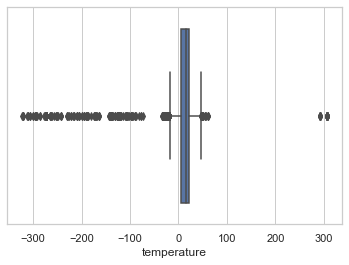

In [10]:
import seaborn as sns
sns.set(style='whitegrid')
ax = sns.boxplot(x=data['temperature'])

In [11]:
#highest recorded temperature taken by a satellite is 66.8 °C by satellite,
#lowest recorded in China is -58; filter out temperatures outside this range
valid_temp = (data['temperature'] >= -60) & (data['temperature'] <= 66.8)

data = data[valid_temp]

#### Wind speed

In [12]:
#given stationary measurements being taken, and units km/hour, wind speed should not be negative
valid_wind = data['wind'] >= 0
data = data[valid_wind]

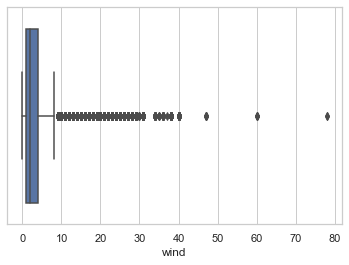

In [13]:
sns.set(style='whitegrid')
ax = sns.boxplot(x=data['wind'])

In [14]:
#those above 40 suggest outliers
valid_wind2 = data['wind'] < 40
data = data[valid_wind2]

#### Air pressure

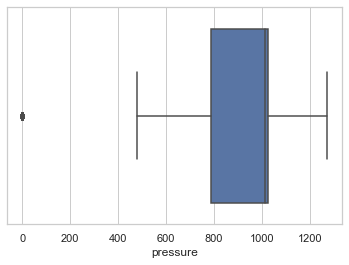

In [15]:
sns.set(style='whitegrid')
ax = sns.boxplot(x=data['pressure'])

In [16]:
#highest atmospheric pressure recorded was 1085mb, so will remove any above 1085
#minimum on Mount Everest 265, and boxplot suggests none below 400, filtering showed only 
#one below 500, so lower limit set to 500
valid_pressure = data['pressure'] <= 1085
valid_pressure2 = data['pressure'] > 500
data = data[valid_pressure & valid_pressure2]

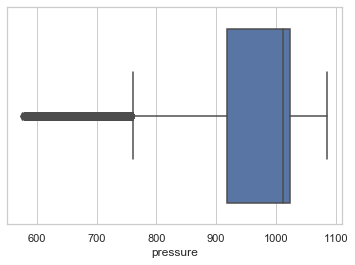

In [17]:
sns.set(style='whitegrid')
ax = sns.boxplot(x=data['pressure'])

#### Humidity

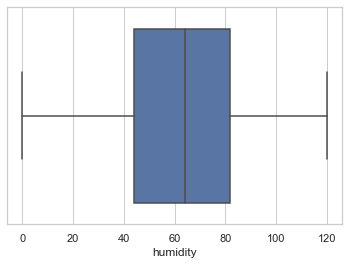

In [18]:
sns.set(style='whitegrid')
ax = sns.boxplot(x=data['humidity'])

#### PM25

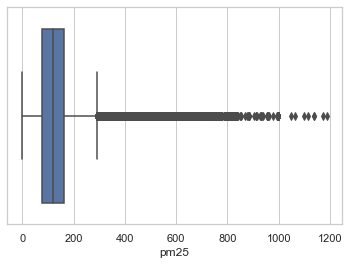

In [19]:
sns.set(style='whitegrid')
ax = sns.boxplot(x=data['pm25'])

In [20]:
#from news stories, pm2.5 levels have reached very high levels, however, national average is 61
#lets see how many readings are above 400 and above 300 to see if filtering out these values
#would significantly reduce the dataset
above_400 = data['pm25'] > 400
above_4h = data[above_400]
print("Above 400: ", above_4h.shape)

above_300 = data['pm25'] > 300
above_3h = data[above_300]
print("Above 300: ", above_3h.shape)

Above 400:  (8482, 11)
Above 300:  (25721, 11)


In [21]:
#where do these high readings belong? is it broadly dispersed or is it only a few locations 
#producing these high readings?
print("Above 400 unique locations: ", len(above_4h.locationid.unique()))
print("Above 300 unique locations: ", len(above_3h.locationid.unique()))

Above 400 unique locations:  595
Above 300 unique locations:  855


In [22]:
#the values are distributed over a number of stations so it is unlikely to be a reading error
#on a single station. But given there are not a large number above 300 relative to total, 
#these will be filtered out
valid_pm25 = data['pm25'] <= 300
data = data[valid_pm25]

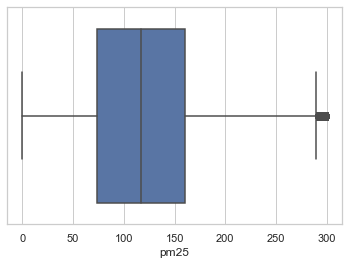

In [23]:
sns.set(style='whitegrid')
ax = sns.boxplot(x=data['pm25'])

In [24]:
data.shape

(1564758, 11)

### Convert unix time to China time

In [25]:
#convert unix GMT to China time (+28800)
data['china_time'] = data['unix_time'] + 28800

In [26]:
#convert unix time to parsed time
data['parsed_time'] = pd.to_datetime(data['china_time'], unit='s')

# split datetime into separate columns
data['Year'] = data['parsed_time'].dt.year
data['Month'] = data['parsed_time'].dt.month
data['Day'] = data['parsed_time'].dt.day
data['time'] = data['parsed_time'].dt.hour

#remove unwanted columns
del data['china_time']
del data['unix_time']

In [27]:
data.time.unique()

array([19, 20, 21, 22,  1,  2,  3,  4,  5,  6,  9, 10, 11, 12, 13, 14, 17,
       18,  7, 15,  0,  8, 23, 16])

In [28]:
print(data.parsed_time.max())
print(data.parsed_time.min())

2016-02-05 09:00:01
2014-02-08 03:00:00


### Doubled up data

On inspection, some stations appear to have the data duplicated. This can be corrected by dropping duplicates

In [29]:
data = data.drop_duplicates(subset=['locationid', 'parsed_time'], keep='first')

In [30]:
data.shape

(1536274, 15)

### NaN values

In [31]:
data.isnull().sum()

locationid          0
stationname         0
latitude            0
longitude           0
pm25                0
temperature         0
dewpoint       160689
pressure            0
humidity            1
wind                0
parsed_time         0
Year                0
Month               0
Day                 0
time                0
dtype: int64

### Explore correlations to ensure independence and remove redundancies

With a high number of null values for nan, before removing nan I will check to see if it can be removed if it correlates highly with other weather measurements

In [32]:
data.corr()

,locationid,latitude,longitude,pm25,temperature,dewpoint,pressure,humidity,wind,Year,Month,Day,time
locationid,1.000000,-0.029060,-0.166811,-0.076471,-0.041729,0.029913,-0.160101,0.048379,-0.121785,0.225191,0.056410,0.006099,0.100191
latitude,-0.029060,1.000000,0.291617,0.146429,-0.409089,-0.503461,0.035565,-0.353636,0.015521,-0.024294,-0.008098,-0.000067,-0.003632
longitude,-0.166811,0.291617,1.000000,0.027005,-0.107826,-0.119779,0.026993,-0.018524,0.078678,-0.028452,-0.011246,-0.001267,-0.045178
pm25,-0.076471,0.146429,0.027005,1.000000,-0.219817,-0.146370,0.193333,0.033464,-0.078651,-0.121470,-0.099321,0.043490,-0.042140
temperature,-0.041729,-0.409089,-0.107826,-0.219817,1.000000,0.853357,-0.148456,0.063446,0.060875,-0.175941,0.207903,0.059247,0.088408
dewpoint,0.029913,-0.503461,-0.119779,-0.146370,0.853357,1.000000,-0.127877,0.493968,-0.065456,-0.187497,0.221439,0.078611,0.008239
pressure,-0.160101,0.035565,0.026993,0.193333,-0.148456,-0.127877,1.000000,0.009619,0.179643,-0.488159,-0.094058,-0.018181,0.002015
humidity,0.048379,-0.353636,-0.018524,0.033464,0.063446,0.493968,0.009619,1.000000,-0.172488,-0.066827,0.066871,0.048038,-0.133318
wind,-0.121785,0.015521,0.078678,-0.078651,0.060875,-0.065456,0.179643,-0.172488,1.000000,-0.282722,-0.177792,-0.028431,0.104915
Year,0.225191,-0.024294,-0.028452,-0.121470,-0.175941,-0.187497,-0.488159,-0.066827,-0.282722,1.000000,-0.351624,-0.027421,-0.025402


With dewpoint having a high positive correlation of 0.86 with temperature, removing it should not have a huge effect (temperature should cover dewpoint effects

In [33]:
del data['dewpoint']

In [34]:
#remove the one humidity null value
data = data.dropna()
data.isnull().sum()

locationid     0
stationname    0
latitude       0
longitude      0
pm25           0
temperature    0
pressure       0
humidity       0
wind           0
parsed_time    0
Year           0
Month          0
Day            0
time           0
dtype: int64

In [35]:
data = data.astype({"time": int})

In [36]:
data.shape

(1536273, 14)

In [37]:
data.head()

,locationid,stationname,latitude,longitude,pm25,temperature,pressure,humidity,wind,parsed_time,Year,Month,Day,time
0,522,"Chengbei water plant, Huzhou",30.891155,120.096593,134.0,20.0,1016.0,52.0,13.0,2014-03-24 19:00:00,2014,3,24,19
1,523,"Jishan new village, Huzhou",30.859939,120.120168,158.0,19.0,1016.0,60.0,9.0,2014-03-24 19:00:00,2014,3,24,19
2,524,"Town west water plant, Huzhou",30.862371,120.084577,147.0,19.0,1016.0,60.0,9.0,2014-03-24 19:00:00,2014,3,24,19
3,525,Huzhou,30.892304,120.091694,151.0,19.0,1016.0,60.0,9.0,2014-03-24 19:00:00,2014,3,24,19
4,526,"Donghu middle school, Shaoxing",29.990447,120.647547,78.0,22.0,1016.0,41.0,4.0,2014-03-24 19:00:00,2014,3,24,19


In [38]:
#save dataset, ready for visualisation
data.to_pickle('pm25_df.pkl')

## Visualising variables

A time series would be difficult to do, given the likely variation in weather conditions between locations at any given time

The data will first be visualised by comparing mean variations per month for variables and per day - this will show whether variables vary in the same pattern, and so whether they can be considered as good variables to build a model with to predict pm2.5

A heatmap will be plotted to view changes in different locations over the course of the year

In [39]:
#load dataset
pm25_df = pd.read_pickle('pm25_df.pkl')

In [40]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

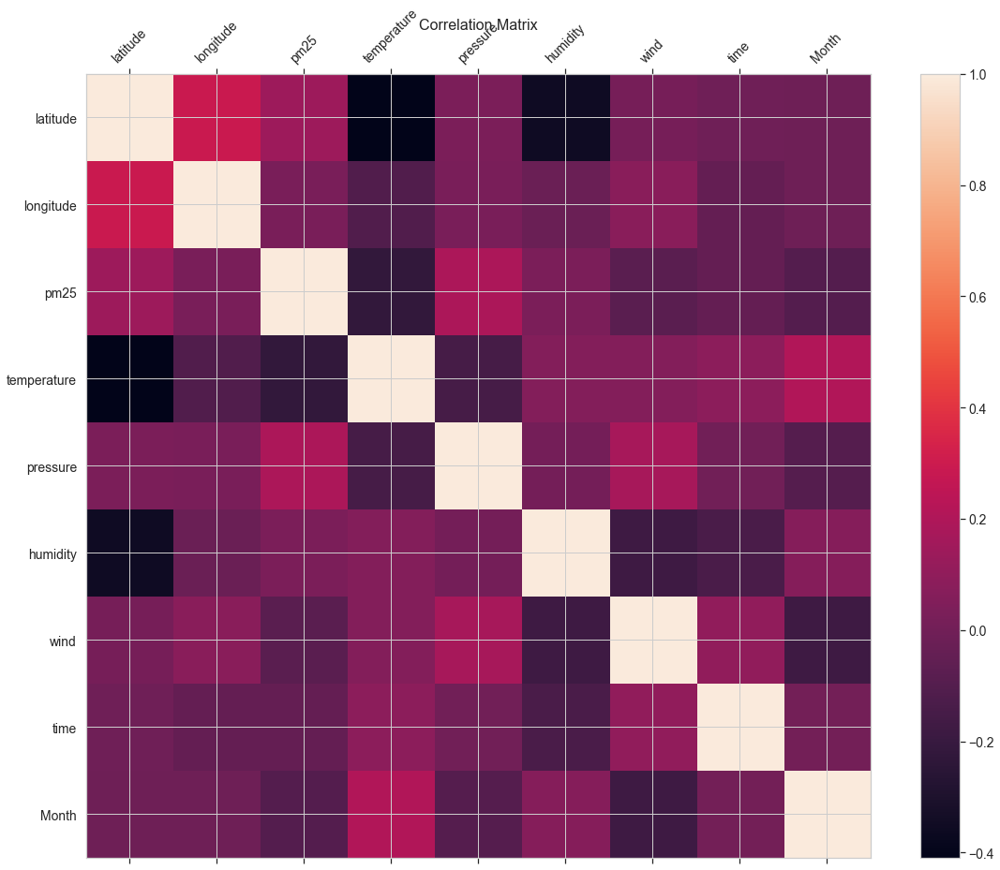

In [41]:
#plot correlations
data_measures = pm25_df[['latitude','longitude','pm25','temperature','pressure','humidity','wind','time','Month']]
f = plt.figure(figsize=(19, 15))
plt.matshow(data_measures.corr(), fignum=f.number)
plt.xticks(range(data_measures.shape[1]), data_measures.columns, fontsize=14, rotation=45)
plt.yticks(range(data_measures.shape[1]), data_measures.columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

### Location

In [42]:
def generateBaseMap(default_location=[35.8617, 104.1954], default_zoom_start=4):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map

In [43]:
import datetime
pm25_df['datetime'] = pd.to_datetime(dict(year=pm25_df.Year, month=pm25_df.Month, day=pm25_df.Day))


In [44]:
df_date_list = []
for datetime in pm25_df.datetime.sort_values().unique():
    df_date_list.append(pm25_df.loc[pm25_df.datetime == datetime, ['latitude','longitude','pm25']].groupby(['latitude','longitude']).sum().reset_index().values.tolist())                  
                       

In [45]:
import folium
from folium.plugins import HeatMapWithTime
base_map = generateBaseMap()
HeatMapWithTime(df_date_list, radius=10, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

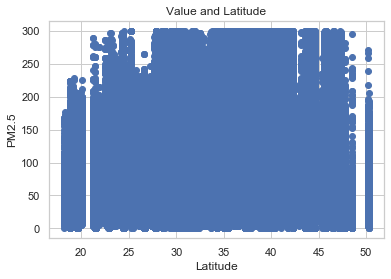

In [46]:
#latitude and pm2.5
x = pm25_df.latitude
y = pm25_df.pm25
plt.scatter(x,y)
plt.xlabel('Latitude')
plt.ylabel('PM2.5')
plt.title('Value and Latitude')
plt.show()

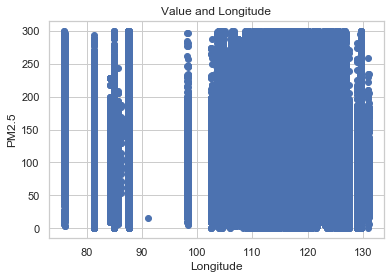

In [47]:
#longitude and pm25
x = pm25_df.longitude
y = pm25_df.pm25
plt.scatter(x,y)
plt.xlabel('Longitude')
plt.ylabel('PM2.5')
plt.title('Value and Longitude')
plt.show()

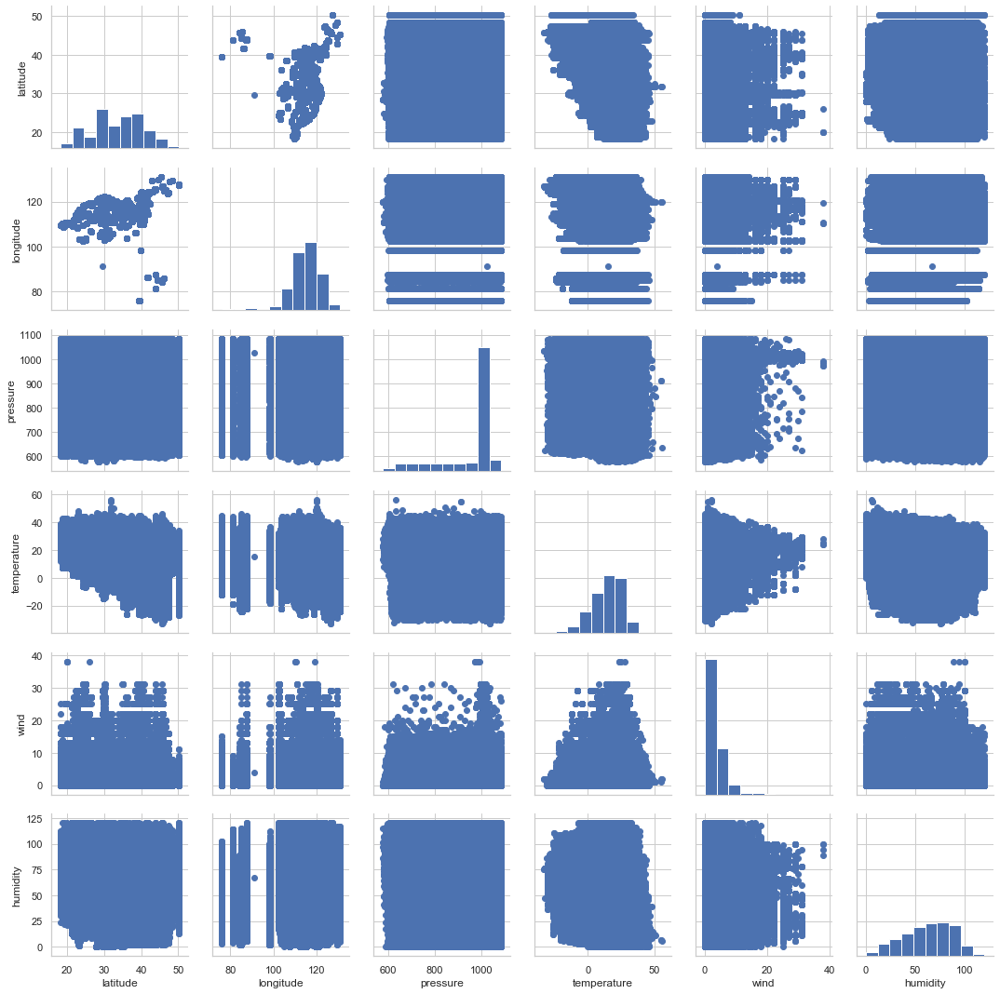

In [48]:
#is weather variation linked to latitude and longitude (can latter be considered independent variables) 
g = sns.PairGrid(pm25_df, vars=["latitude", "longitude", "pressure", "temperature", 'wind','humidity'])
g.map_diag(plt.hist)
g.map_offdiag(plt.scatter)

### Weather variables and PM2.5

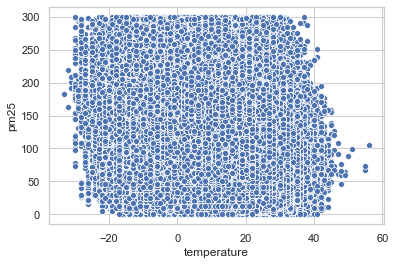

In [49]:
ax = sns.scatterplot(x='temperature',y='pm25', data=pm25_df)

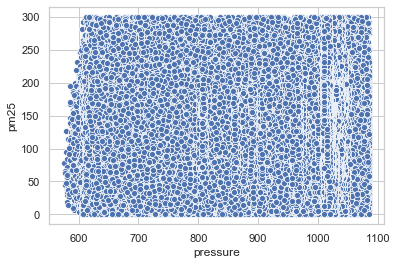

In [50]:
ax = sns.scatterplot(x='pressure',y='pm25', data=pm25_df)

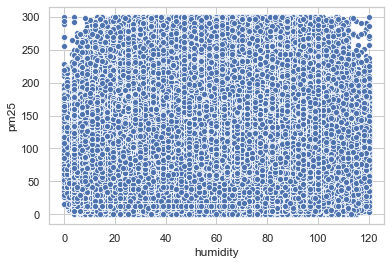

In [51]:
ax = sns.scatterplot(x='humidity',y='pm25', data=pm25_df)

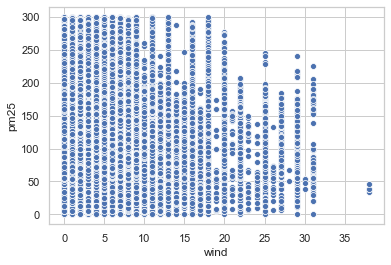

In [52]:
ax = sns.scatterplot(x='wind',y='pm25', data=pm25_df)

### Month, weather variables and pm2.5

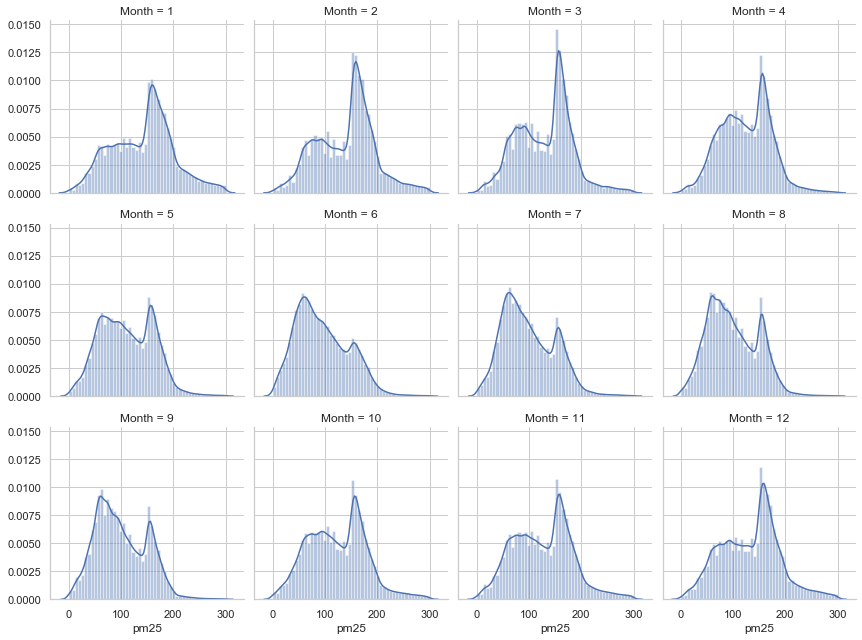

In [53]:
#variation of pm25 with month
g = sns.FacetGrid(pm25_df, col='Month', col_wrap=4)
g.map(sns.distplot, "pm25")
plt.show()

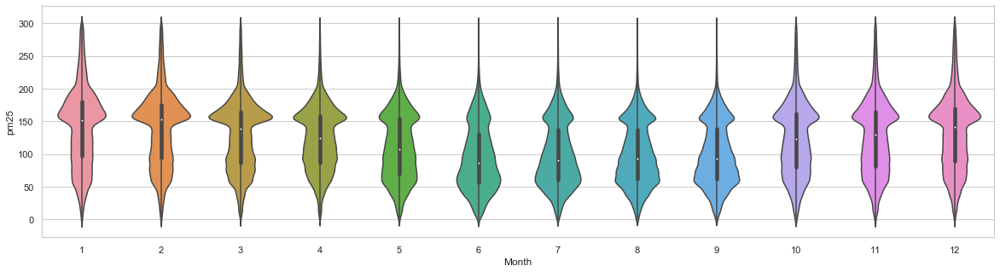

In [54]:
plt.figure(figsize=(20,5))
ax = sns.violinplot(x="Month", y="pm25", data=pm25_df)

#### Does the relation between pm2.5 and weather variables vary between months?

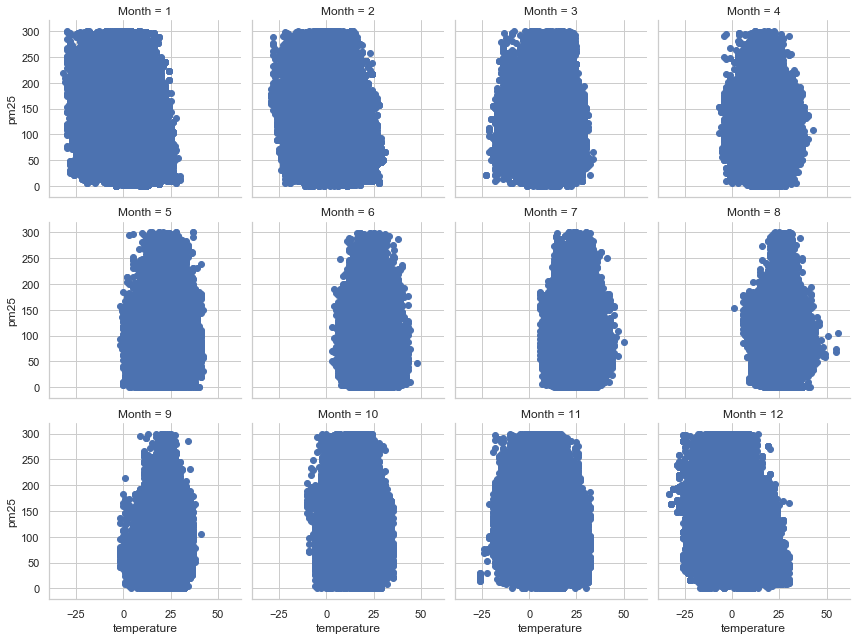

In [55]:
#temperature and pm2.5 per month
g = sns.FacetGrid(pm25_df, col='Month', col_wrap=4)
g.map(plt.scatter, "temperature","pm25")
plt.show()

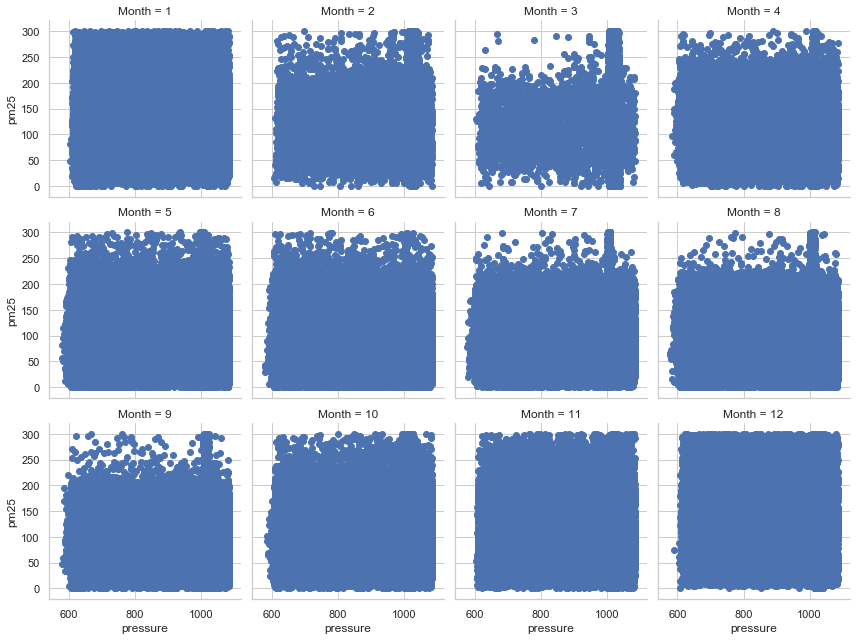

In [56]:
#pressure and pm2.5 per month
g = sns.FacetGrid(pm25_df, col='Month', col_wrap=4)
g.map(plt.scatter, "pressure","pm25")
plt.show()

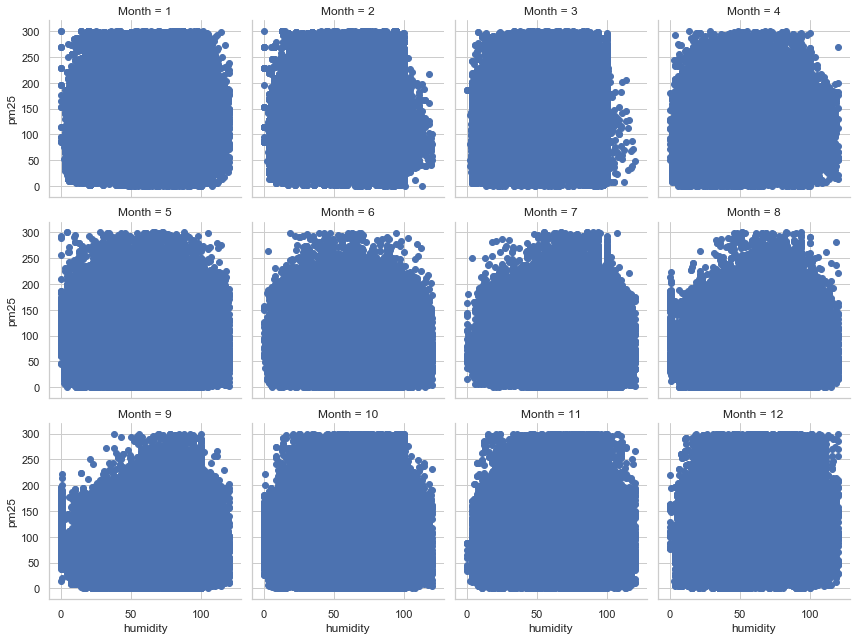

In [57]:
#humidity and pm2.5 per month
g = sns.FacetGrid(pm25_df, col='Month', col_wrap=4)
g.map(plt.scatter, "humidity","pm25")
plt.show()

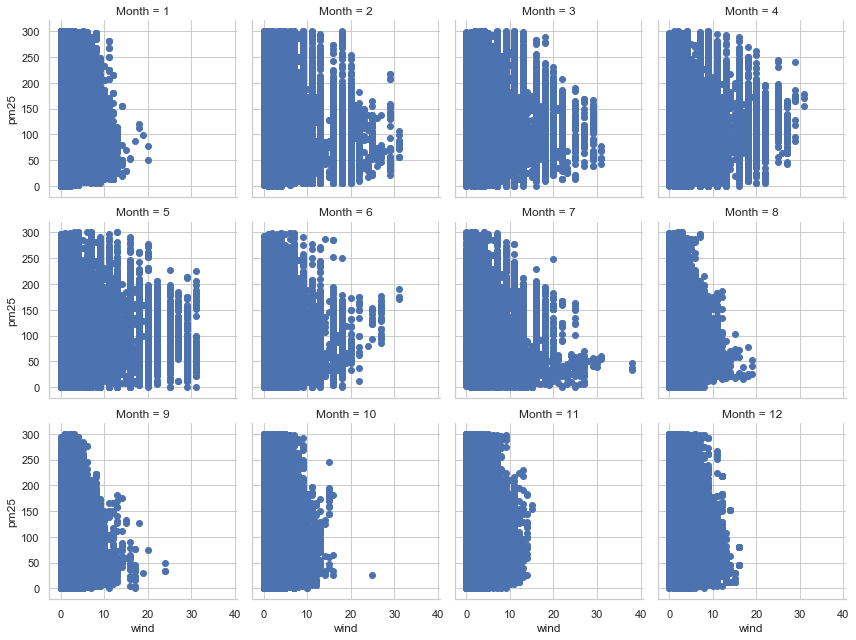

In [58]:
#wind speed and pm2.5 per month
g = sns.FacetGrid(pm25_df, col='Month', col_wrap=4)
g.map(plt.scatter, "wind","pm25")
plt.show()

### Hour of the day, weather variables and pm2.5

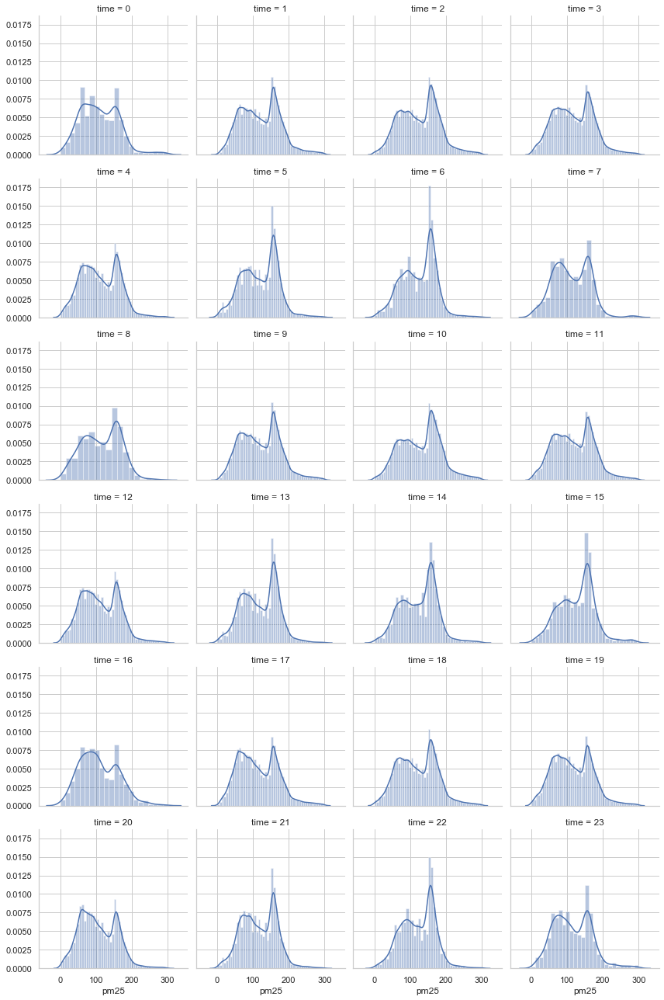

In [59]:
#variation of pm25 with hour of day
g = sns.FacetGrid(pm25_df, col='time', col_wrap=4)
g.map(sns.distplot, "pm25")
plt.show()

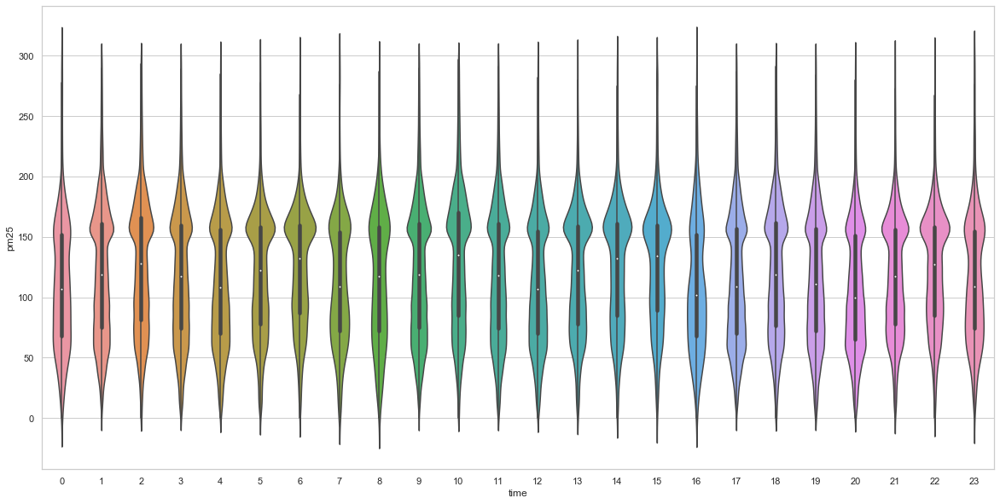

In [60]:
plt.figure(figsize=(20,10))
ax = sns.violinplot(x="time", y="pm25", data=pm25_df)

#### Does the relation between pm2.5 and weather variables vary during the day?

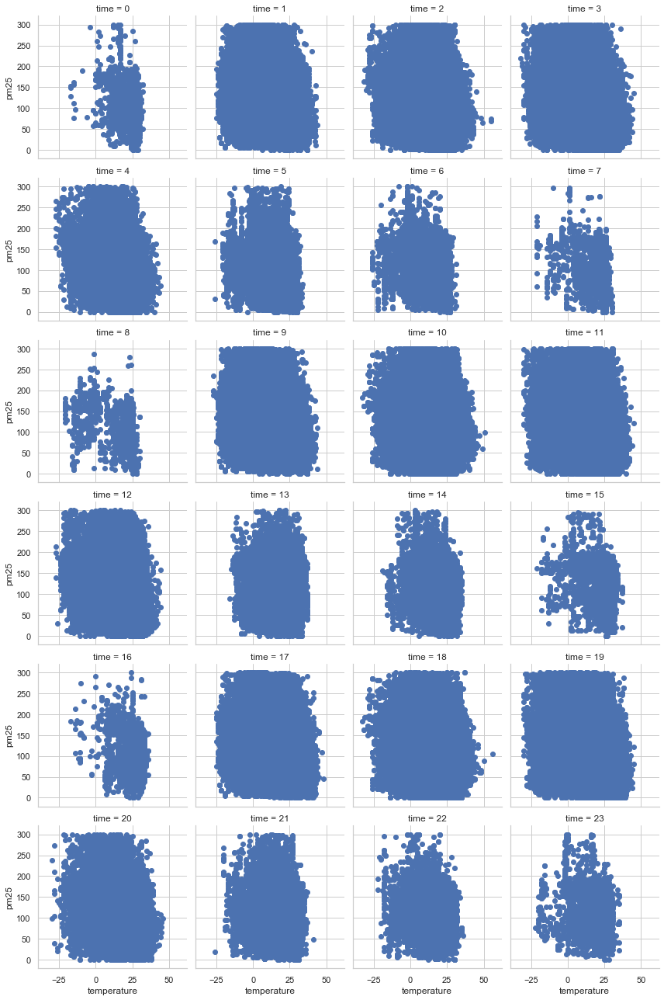

In [61]:
#temp and pm25 per hour
g = sns.FacetGrid(pm25_df, col='time', col_wrap=4)
g.map(plt.scatter, "temperature","pm25")
plt.show()

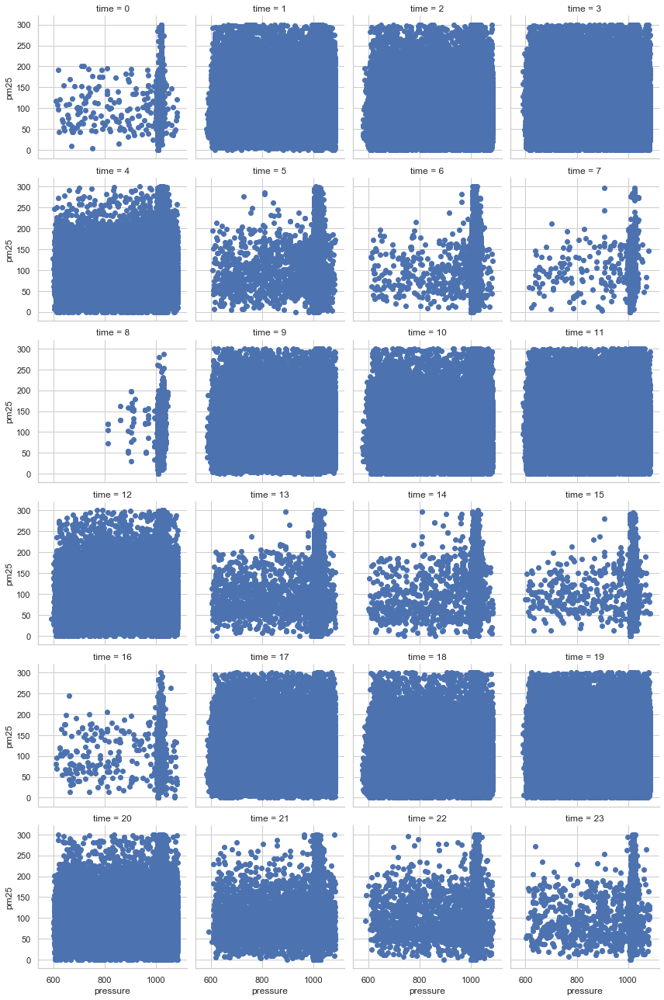

In [62]:
#pressure and pm25 per hour
g = sns.FacetGrid(pm25_df, col='time', col_wrap=4)
g.map(plt.scatter, "pressure","pm25")
plt.show()

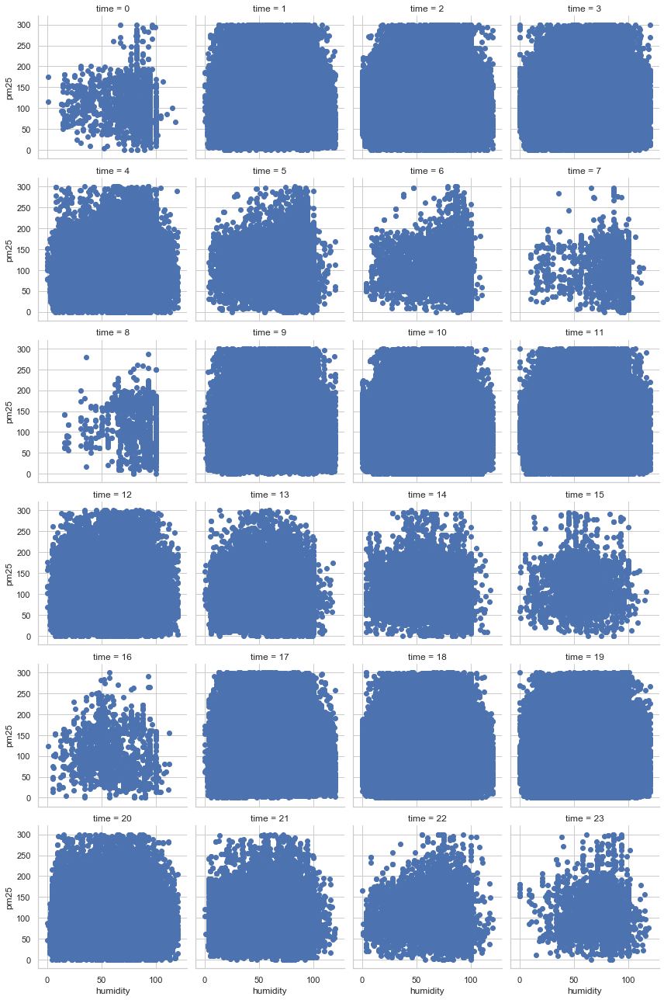

In [63]:
#humidity and pm25 per hour
g = sns.FacetGrid(pm25_df, col='time', col_wrap=4)
g.map(plt.scatter, "humidity","pm25")
plt.show()

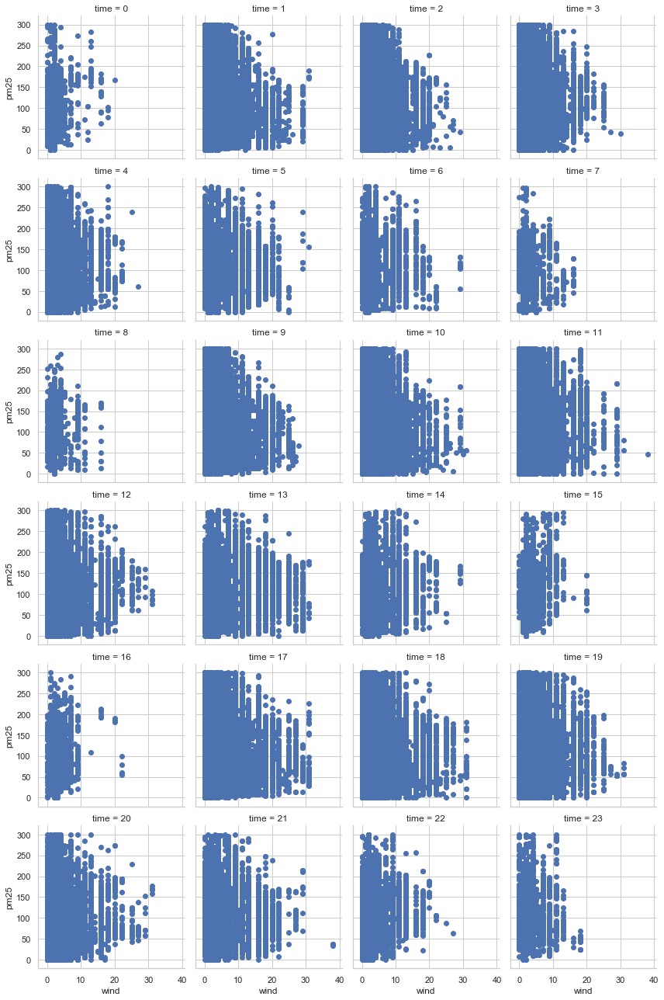

In [64]:
#wind speed and pm25 per hour
g = sns.FacetGrid(pm25_df, col='time', col_wrap=4)
g.map(plt.scatter, "wind","pm25")
plt.show()

### Day of the week

This may impact pm2.5 levels - increased commuting and industry activity during certain weekdats, increased leisure other days

In [65]:
import datetime as dt

pm25_df['day_week'] = pm25_df['datetime'].dt.weekday_name

In [66]:
pm25_df.head()

,locationid,stationname,latitude,longitude,pm25,temperature,pressure,humidity,wind,parsed_time,Year,Month,Day,time,datetime,day_week
0,522,"Chengbei water plant, Huzhou",30.891155,120.096593,134.0,20.0,1016.0,52.0,13.0,2014-03-24 19:00:00,2014,3,24,19,2014-03-24,Monday
1,523,"Jishan new village, Huzhou",30.859939,120.120168,158.0,19.0,1016.0,60.0,9.0,2014-03-24 19:00:00,2014,3,24,19,2014-03-24,Monday
2,524,"Town west water plant, Huzhou",30.862371,120.084577,147.0,19.0,1016.0,60.0,9.0,2014-03-24 19:00:00,2014,3,24,19,2014-03-24,Monday
3,525,Huzhou,30.892304,120.091694,151.0,19.0,1016.0,60.0,9.0,2014-03-24 19:00:00,2014,3,24,19,2014-03-24,Monday
4,526,"Donghu middle school, Shaoxing",29.990447,120.647547,78.0,22.0,1016.0,41.0,4.0,2014-03-24 19:00:00,2014,3,24,19,2014-03-24,Monday


In [67]:
pm25_df['day_week_cat'] = pm25_df.day_week.astype("category").cat.codes

In [68]:
weekday_load = pm25_df[['pm25', 'day_week_cat']].groupby(['day_week_cat']).mean()

In [69]:
weekday_load

,pm25
day_week_cat,
0,119.286542
1,118.767922
2,120.843416
3,119.315474
4,117.277162
5,120.018184
6,118.923182


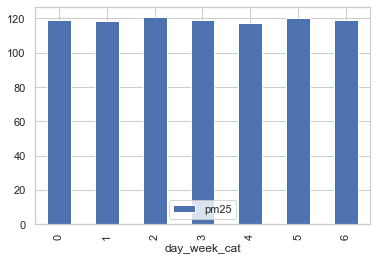

In [70]:
weekday_load.plot(kind='bar')

In [71]:
pm25_df = pm25_df.drop(labels='day_week', axis=1)

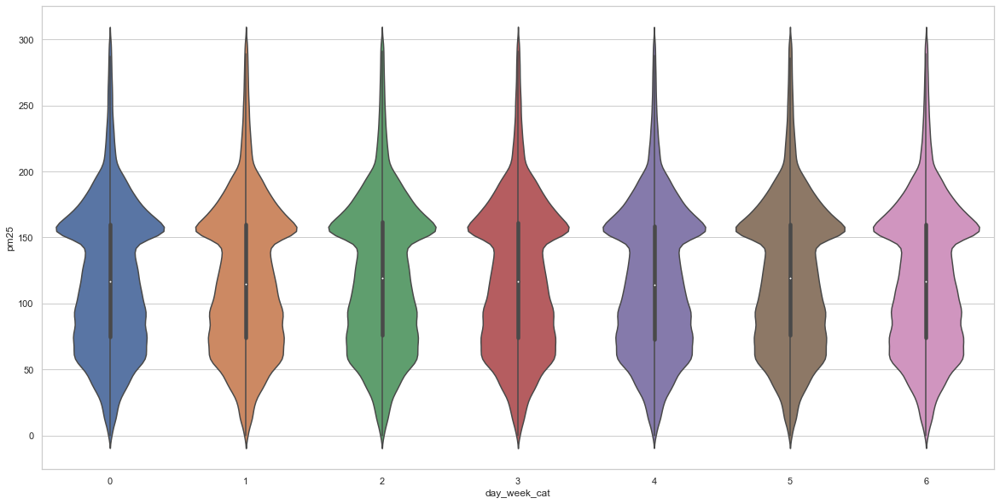

In [72]:
plt.figure(figsize=(20,10))
ax = sns.violinplot(x="day_week_cat", y="pm25", data=pm25_df)

In [73]:
del pm25_df['day_week_cat']

In [74]:
#save dataset, ready for building the model
pm25_df.to_pickle('data.pkl')

What visualisations have shown:
+ There is no apparent relationship between day of the week and PM2.5 concentration, so this variable can be left out of the model
+ From the correlation grid, no individual factor is strongly (positively or negatively) correlated with PM2.5 concentration
+ Some variability of PM2.5 at different latitudes and longitudes as shown by the heatmap over time and the scatterplots - possibly due to industry hotspots. From the PairGrid plot, despite some relation between temperature and latitude, there is very little relation between coordinates and weather conditions. Therefore, location should be considered as a feature to include in prediction of PM2.5 concentrations
+ PM2.5 concentration distribution varies by month. The relationship between PM2.5 and temperature, pressure, humidity and wind speed also appears to vary slightly by month to varying degrees (more so for temperature and wind speed with PM2.5) likely due to climate changes throughout the year, but may also be linked to variables not recorded, so month is a good variable to include
+ PM2.5 concentration varies by time of day. Some of the variation visualised may be due to certain hours of the day having more data than others. The relationship between PM2.5 and temperature, pressure, humidity and wind speed also appears to vary by hour of the day to varying degrees. As for month, likely due at least to some degree due to changes in weather conditions throughout the day, but may also be linked to variables not recorded, so hour is a good variable to include
+ Individually, except for wind speed there appears to be very little relationship between weather conditions and PM2.5. It is possible that the interaction of weather conditions helps determine the PM2.5 concentration and so it is worth retaining all weather variables

## Data Preparation

In [2]:
#load data
df_pm25 = pd.read_pickle('data.pkl')

In [3]:
df_pm25.columns

Index(['locationid', 'stationname', 'latitude', 'longitude', 'pm25',
       'temperature', 'pressure', 'humidity', 'wind', 'parsed_time', 'Year',
       'Month', 'Day', 'time', 'datetime'],
      dtype='object')

In [4]:
#drop unwanted columns
df_pm25.drop(['locationid', 'stationname', 'parsed_time','Year','Day','datetime'], axis=1, inplace=True)

### One Hot Encode Categorical Features (not for tree-based algorithms)

Date features, as numerical values, do not provide value as a higher month number or time number does not necessarily correlate to PM2.5 concentration (e.g. an increasing time does not mean either a direct increase or decrease in concentration - it is possibly a cyclical relationship, where as time increases PM2.5 fluctuates, which is suggested by the above visualisations).

In [5]:
cat_cols = ['Month','time']

X_ohe = pd.get_dummies(df_pm25, prefix_sep="_", columns=cat_cols)

### Train-Test Split

In [6]:
from sklearn.model_selection import train_test_split

In [7]:
Y_oh = X_ohe[['pm25']]
X_oh = X_ohe.drop('pm25', axis=1)

Y = df_pm25[['pm25']]
X = df_pm25.drop('pm25', axis=1)

In [8]:
#creating _orig train set so this can later be used to train final model (will include validation)
X_train_oh, X_test_oh, y_train_oh, y_test_oh = train_test_split(X_oh, Y_oh, test_size=0.2, random_state=42)

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

In [9]:
len(X_train), len(y_train), len(X_test), len(y_test)

(1229018, 1229018, 307255, 307255)

In [10]:
len(X_train_oh), len(y_train_oh), len(X_test_oh), len(y_test_oh)

(1229018, 1229018, 307255, 307255)

In [11]:
X_train.to_csv('X_train.csv')
y_train.to_csv('y_train.csv')
X_test.to_csv('X_test.csv')
y_test.to_csv('y_test.csv')

## Building the models 

Ideally, trian and validation would remain as a single set and kfold cross validation would be used. But as this is a large dataset, and to reduce computing power and runtime, models will be trained on train set and evaluated on the validation set. The final best performing model will then be trained on the entire training-and-validation data, and tested on the test set.

Code for hyperparameter tuning is also included, but with existing computing power it would take too long to run.

In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

Models to train and test:
+ Linear Regression
+ Decision Tree Regressor
+ Gradient Boosting Regressor
+ Adaboost Regressor
+ XGBoost
+ Light GBM
+ Random Forest
+ Extra Trees

To find optimal parameters for each model, RandomizedSearchCV will be used as this will cut down on run time (GridSearchCV would be optimal, but given large number of parameters, we want to reduce runtime).

Then, KFold cross-validation will be used on train data and RMSE calculated for comparison on performance between models.

## Implement Regression Algorithms

In [16]:
from sklearn.metrics import mean_squared_error
from math import sqrt

from sklearn.linear_model import LinearRegression
from sklearn import model_selection
from sklearn.model_selection import RandomizedSearchCV
from sklearn.pipeline import Pipeline
seed = 42

from sklearn import preprocessing
mms = preprocessing.MinMaxScaler()
import warnings
warnings.filterwarnings("ignore")

#### Linear Regression (use one-hot encoded data)

In [14]:
kfold = model_selection.KFold(n_splits=10, random_state=seed)
lr_pipe = Pipeline([
    ('mms', mms),
    ('lr', LinearRegression())])
    
scoring = 'neg_mean_squared_error'
results_oh = model_selection.cross_val_score(lr_pipe, X_train_oh, y_train_oh, cv=kfold, scoring=scoring)
print(("RMSE: %.3f") % sqrt(abs(results_oh.mean())))

RMSE: 49.991


In [15]:
kfold = model_selection.KFold(n_splits=10, random_state=seed)
lr_pipe = Pipeline([
    ('mms', mms),
    ('lr', LinearRegression())])
    
scoring = 'neg_mean_squared_error'
results = model_selection.cross_val_score(lr_pipe, X_train, y_train, cv=kfold, scoring=scoring)
print(("RMSE: %.3f") % sqrt(abs(results.mean())))

RMSE: 52.128


In [16]:
dfRMSE = pd.DataFrame(columns=['Algorithm', 'RMSE'])
dfRMSE = dfRMSE.append({'Algorithm': 'LinearRegression', 'RMSE': sqrt(abs(results_oh.mean()))}, ignore_index=True)

#### Decision Tree Regressor (use un-one-hot encoded data)

For hyperparameter tuning:

    params_dt = {"criterion": ["mse", "mae"],
                 "min_samples_split": [10, 20, 40],
                 "max_depth": [2, 6, 8],
                 "min_samples_leaf": [20, 40, 100],
                 "max_leaf_nodes": [5, 20, 100],
                }

    grid_search_dt = RandomizedSearchCV(DecisionTreeRegressor(),params_dt,cv=5,verbose=0,random_state=seed)
    grid_search_dt.fit(X_train, y_train)
    dt_params = grid_search_dt.best_params_

In [17]:
from sklearn.tree import DecisionTreeRegressor

In [18]:
kfold = model_selection.KFold(n_splits=10, random_state=seed)
dt_pipe = Pipeline([
    ('mms', mms),
    ('dt', DecisionTreeRegressor())])
scoring = 'neg_mean_squared_error'
results = model_selection.cross_val_score(dt_pipe, X_train, y_train, cv=kfold, scoring=scoring)
print(("RMSE: %.3f") % sqrt(abs(results.mean())))

RMSE: 40.162


In [19]:
dfRMSE = dfRMSE.append({'Algorithm': 'DecisionTreeRegressor', 'RMSE': sqrt(abs(results.mean()))}, ignore_index=True)

#### Gradient Boosting Regressor

In [20]:
from sklearn.ensemble import GradientBoostingRegressor

In [21]:
kfold = model_selection.KFold(n_splits=10, random_state=seed)
gbdt_pipe = Pipeline([
    ('mms', mms),
    ('gbdt', GradientBoostingRegressor(random_state=seed))])
scoring = 'neg_mean_squared_error'
results = model_selection.cross_val_score(gbdt_pipe, X_train, y_train, cv=kfold, scoring=scoring)
print(("RMSE: %.3f") % sqrt(abs(results.mean())))

RMSE: 45.568


In [22]:
dfRMSE = dfRMSE.append({'Algorithm': 'GradientBoostingRegressor', 'RMSE': sqrt(abs(results.mean()))}, ignore_index=True)

#### Adaboost

For hyperparameter tuning:        

    params_ada = {
        'n_estimators': [1, 2, 4, 8, 16, 32, 64, 100, 200]
    }

    grid_search_ada = RandomizedSearchCV(AdaBoostRegressor(), params_ada, cv=3, verbose=1, n_jobs=-1,random_state=seed)
    grid_search_ada.fit(X_train_norm, y_train)
    ada_params = grid_search_ada.best_params_

In [23]:
from sklearn.ensemble import AdaBoostRegressor

In [24]:
kfold = model_selection.KFold(n_splits=10, random_state=seed)
ada_pipe = Pipeline([
    ('mms', mms),
    ('ada', AdaBoostRegressor())])
scoring = 'neg_mean_squared_error'
results = model_selection.cross_val_score(ada_pipe, X_train, y_train, cv=kfold, scoring=scoring)
print(("RMSE: %.3f") % sqrt(abs(results.mean())))

RMSE: 49.702


In [25]:
dfRMSE = dfRMSE.append({'Algorithm': 'AdaBoostRegressor', 'RMSE': sqrt(abs(results.mean()))}, ignore_index=True)

#### XGBoost

For hyperparameter tuning:     

    params_xgb = {
        'objective': ['reg:squarederror'],
        'gamma': [i/10.0 for i in range(0,5)],
        'max_depth': [3, 5, 7, 9],
        'min_child_weight': [1,2,4,6],
        'subsample': [i/10.0 for i in range(6,10)],
        'colsample_bytree': [i/10.0 for i in range(6,10)],
        'n_estimators': [50, 100, 150, 200, 500]
    }

    grid_search_xgb = RandomizedSearchCV(xgb.XGBRegressor(), params_xgb, cv=3, verbose=1, n_jobs=-1,random_state=seed)
    grid_search_xgb.fit(X_train_norm, y_train)
    xgb_params = grid_search_xgb.best_params_

In [26]:
import xgboost as xgb

In [27]:
#categorical not ohe - performs better than ohe
kfold = model_selection.KFold(n_splits=10, random_state=seed)
xgb_pipe = Pipeline([
    ('mms', mms),
    ('xgb', xgb.XGBRegressor(objective='reg:squarederror',random_state=seed))])
scoring = 'neg_mean_squared_error'
results = model_selection.cross_val_score(xgb_pipe, X_train, y_train, cv=kfold, scoring=scoring)
print(("RMSE: %.3f") % sqrt(abs(results.mean())))
#this performs better marginally

RMSE: 45.563


In [28]:
dfRMSE = dfRMSE.append({'Algorithm': 'XGBRegressor', 'RMSE': sqrt(abs(results.mean()))}, ignore_index=True)

#### Light GBM

For hyperparameter tuning:    

    params_lgb = {
        'n_estimators': [100, 200, 500, 800, 1000],
        'max_depth':  [4, 5, 8, -1],
        'num_leaves': [15, 31, 80, 127],
        'subsample': [0.6, 0.7, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.7, 0.8, 1.0]
    }

    grid_search_lgb = RandomizedSearchCV(lgb.LGBMRegressor(), params_lgb, cv=3, verbose=1, n_jobs=-1,random_state=seed)
    grid_search_lgb.fit(X_train_norm, y_train)
    lgb_params = grid_search_lgb.best_params_

In [29]:
import lightgbm as lgb

In [30]:
#performed marginally better than with ohe
kfold = model_selection.KFold(n_splits=10, random_state=seed)
lgb_pipe = Pipeline([
    ('mms', mms),
    ('lgb', lgb.LGBMRegressor(seed=seed))])
scoring = 'neg_mean_squared_error'
results = model_selection.cross_val_score(lgb_pipe, X_train, y_train, cv=kfold, scoring=scoring)
print(("RMSE: %.3f") % sqrt(abs(results.mean())))

RMSE: 42.801


In [31]:
dfRMSE = dfRMSE.append({'Algorithm': 'LightGBM', 'RMSE': sqrt(abs(results.mean()))}, ignore_index=True)

#### Random Forest

For hyperparameter tuning:      

    params_rf = {
        'n_estimators': [int(x) for x in np.linspace(start = 100, stop = 2000, num = 10)],
        'max_features': ['auto', 'sqrt'],
        'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, None],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4],
        'bootstrap': [True, False]
    }

    grid_search_rf = RandomizedSearchCV(RandomForestRegressor(), params_rf, cv=3, verbose=1,n_jobs=-1, random_state=seed)
    grid_search_rf.fit(X_train_norm, y_train)
    rf_params = grid_search_rf.best_params_

In [32]:
from sklearn.ensemble import RandomForestRegressor

In [33]:
kfold = model_selection.KFold(n_splits=10, random_state=seed)
rf_pipe = Pipeline([
    ('mms', mms),
    ('rf', RandomForestRegressor(random_state=seed))])
scoring = 'neg_mean_squared_error'
results = model_selection.cross_val_score(rf_pipe, X_train, y_train, cv=kfold, scoring=scoring)
print(("RMSE: %.3f") % sqrt(abs(results.mean())))

RMSE: 29.041


In [34]:
dfRMSE = dfRMSE.append({'Algorithm': 'RandomForestRegressor', 'RMSE': sqrt(abs(results.mean()))}, ignore_index=True)

#### Extra Trees Regression

For hyperparameter tuning:  

    params_et = {
        'n_estimators': [10, 30, 50, 100, 200],
        'max_depth': [None, 7, 9, 11],
        'max_features': ['auto','sqrt','log2',None],
        'min_samples_leaf': [1,5,10],
        'min_samples_split': [2, 5, 10],
    }

    grid_search_et = RandomizedSearchCV(ExtraTreesRegressor(), params_et, cv=5, verbose=0, random_state=seed)
    grid_search_et.fit(X_train, y_train)
    et_params = grid_search_et.best_params_

In [35]:
from sklearn.ensemble import ExtraTreesRegressor

In [36]:
kfold = model_selection.KFold(n_splits=10, random_state=seed)
et_pipe = Pipeline([
    ('mms', mms),
    ('et', ExtraTreesRegressor(random_state=seed))])
scoring = 'neg_mean_squared_error'
results = model_selection.cross_val_score(et_pipe, X_train, y_train, cv=kfold, scoring=scoring)
print(("RMSE: %.3f") % sqrt(abs(results.mean())))

RMSE: 29.425


In [37]:
dfRMSE = dfRMSE.append({'Algorithm': 'ExtraTreesRegressor', 'RMSE': sqrt(abs(results.mean()))}, ignore_index=True)

## Comparing Models

In [38]:
dfRMSE

,Algorithm,RMSE
0,LinearRegression,49.990585
1,DecisionTreeRegressor,40.161971
2,GradientBoostingRegressor,45.567986
3,AdaBoostRegressor,49.701598
4,XGBRegressor,45.563198
5,LightGBM,45.563198
6,RandomForestRegressor,29.040778
7,ExtraTreesRegressor,29.425305


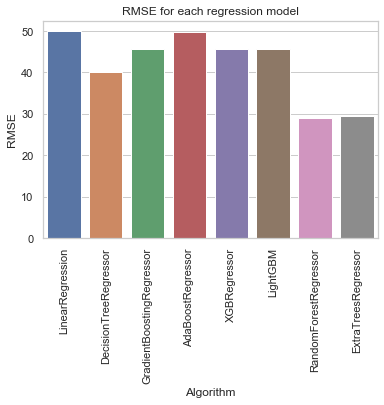

In [39]:
#plot RMSE values
import seaborn as sns
sns.set(style="whitegrid")
ax = sns.barplot(x="Algorithm", y="RMSE", data=dfRMSE)
ax.set_title('RMSE for each regression model')
for item in ax.get_xticklabels():
    item.set_rotation(90)

The best performing model (the model with the lowest RMSE) is Random Forest.

### Hyperparameter tuning for best performing algorithm

In [12]:
from sklearn.ensemble import RandomForestRegressor 

In [14]:
import pickle

with open("RF_Params.pkl", 'rb') as file:
    rf_params = pickle.load(file)

rf_params

{'n_estimators': 200,
 'max_features': 'auto',
 'max_depth': 90,
 'min_samples_split': 2,
 'min_samples_leaf': 1,
 'bootstrap': True}

In [17]:
kfold = model_selection.KFold(n_splits=10, random_state=seed)
rf_pipe = Pipeline([
    ('mms', mms),
    ('rf', RandomForestRegressor(**rf_params, random_state=seed))])
scoring = 'neg_mean_squared_error'
rf_final_results = model_selection.cross_val_score(rf_pipe, X_train, y_train.values.ravel(), cv=kfold, scoring=scoring)
print(("RMSE: %.3f") % sqrt(abs(rf_final_results.mean())))

RMSE: 28.950


## Stacking 

### MLXtend's Stacking Regressor

In [18]:
from mlxtend.regressor import StackingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import AdaBoostRegressor
import xgboost as xgb
import lightgbm as lgb
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import ExtraTreesRegressor

In [19]:
#models
lr_model = LinearRegression()
dt_model = DecisionTreeRegressor(random_state=seed)
gbdt_model = GradientBoostingRegressor(random_state=seed)
ada_model = AdaBoostRegressor(random_state=seed)
xgb_model = xgb.XGBRegressor(objective='reg:squarederror',random_state=seed)
lgb_model = lgb.LGBMRegressor(seed=seed)
rf_model = RandomForestRegressor(**rf_params, random_state=seed)
et_model = ExtraTreesRegressor(random_state=seed)

In [20]:
stregr = StackingRegressor(regressors=[dt_model, xgb_model, lgb_model, rf_model, et_model], 
                           meta_regressor=RandomForestRegressor(random_state=seed))

In [22]:
kfold = model_selection.KFold(n_splits=10, random_state=seed)
stregr_pipe = Pipeline([
    ('mms', mms),
    ('stregr', stregr)])
scoring = 'neg_mean_squared_error'
stregr_results = model_selection.cross_val_score(stregr_pipe, X_train, y_train.values.ravel(), cv=kfold, scoring=scoring)
print(("RMSE: %.3f") % sqrt(abs(stregr_results.mean())))

RMSE: 33.286


## Train final model and generate predictions on test set

The algorithm that performed best on the train set using KFold cross validation was Random Forest Regressor.

This will now be trained on the whole train set, and the model will be used to make predictions on the test set.

In [24]:
X_test = pd.read_csv('X_test.csv')
X_test = X_test.loc[:, ~X_test.columns.str.contains('^Unnamed')]

y_test = pd.read_csv('y_test.csv')
y_test = y_test['pm25'].values

final_model = RandomForestRegressor(**rf_params)
final_model.fit(X_train, y_train.values.ravel())

preds = final_model.predict(X_test)

In [26]:
score = sqrt(mean_squared_error(y_test, preds))
print(score)

28.463484806185946


## Plotting a sample of most successful predictions vs actual

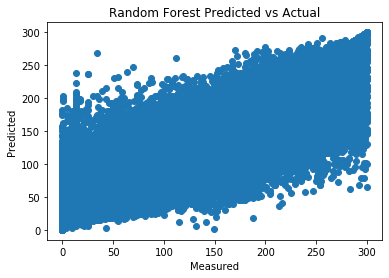

In [25]:
plt.scatter(y_test, preds)
plt.xlabel('Measured')
plt.ylabel('Predicted')
plt.title('Random Forest Predicted vs Actual')
plt.show()

In [28]:
#y_test1 = y_test.reset_index()

df_y = pd.DataFrame({'actual': y_test, 'predicted': preds})

df_sample = df_y.head(50)

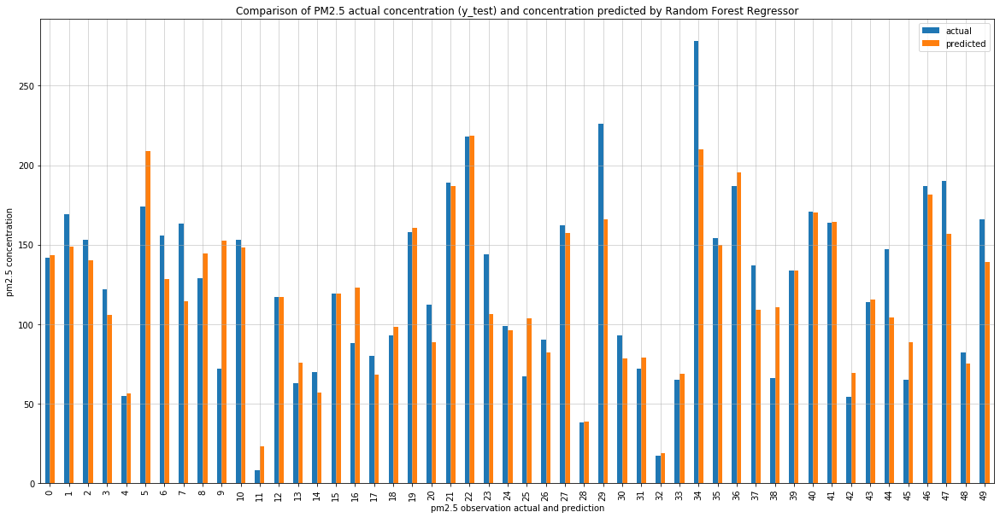

In [29]:
df_sample.plot(kind='bar',figsize=(20,10))
plt.grid(which='major', linestyle='-', linewidth='0.5')
plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
plt.xlabel('pm2.5 observation actual and prediction')
plt.ylabel('pm2.5 concentration')
plt.title('Comparison of PM2.5 actual concentration (y_test) and concentration predicted by Random Forest Regressor')
plt.show()